##  1. 스티커 구하기 or 만들기


## 2. 얼굴 검출 & 랜드마크 검출 하기
 - 오늘 배운 dlib을 이용해서 얼굴의 bounding box 위치와 landmark의 위치를 찾아
 
 
## 3. 스티커 적용 위치 확인하기

![img1](E10im1.png)
볼은 '턱', '눈', '입', '코' 사이에 있다는 점을 이용해 주세요. 비율로 계산하는 방법 잊지 않으셨죠?

[hint] 2, 36, 48, 30 번 인덱스를 이용

## 4. 스티커 적용하기
- (1) 오늘 배운 np.where 를 사용해서 스티커를 적용해 주세요.

- (2) 스티커를 조금 더 자연스럽게 보이게 하려면 어떻게 해야 할까요? 스티커 뒤로 원본 이미지가 같이 보이도록 만들어 봅시다.

[hint] opencv 의 cv2.addWeighted() 를 참고하세요.

## 5. 문제점 찾아보기
- (1) 셀프 카메라를 다양한 각도에서 촬영하면서 스티커를 반복해서 적용해 보세요.

- (2) 문제점이 무엇인지 최대한 자세하게 기록해 보세요. 여러분이 생각한 문제점을 해결하기 위한 방법은 분명 존재합니다!

오늘 만든 스티커앱에서 생각해볼 수 있는 문제점은 다음과 같습니다.

얼굴 각도에 따라 스티커가 어떻게 변해야할까요?
멀리서 촬영하면 왜 안될까요? 옆으로 누워서 촬영하면 왜 안될까요?
실행 속도가 중요할까요?
스티커앱을 만들 때 정확도가 얼마나 중요할까요?


### Library Install
```
$ pip install opencv-python
$ pip install cmake
$ pip install dlib
```

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

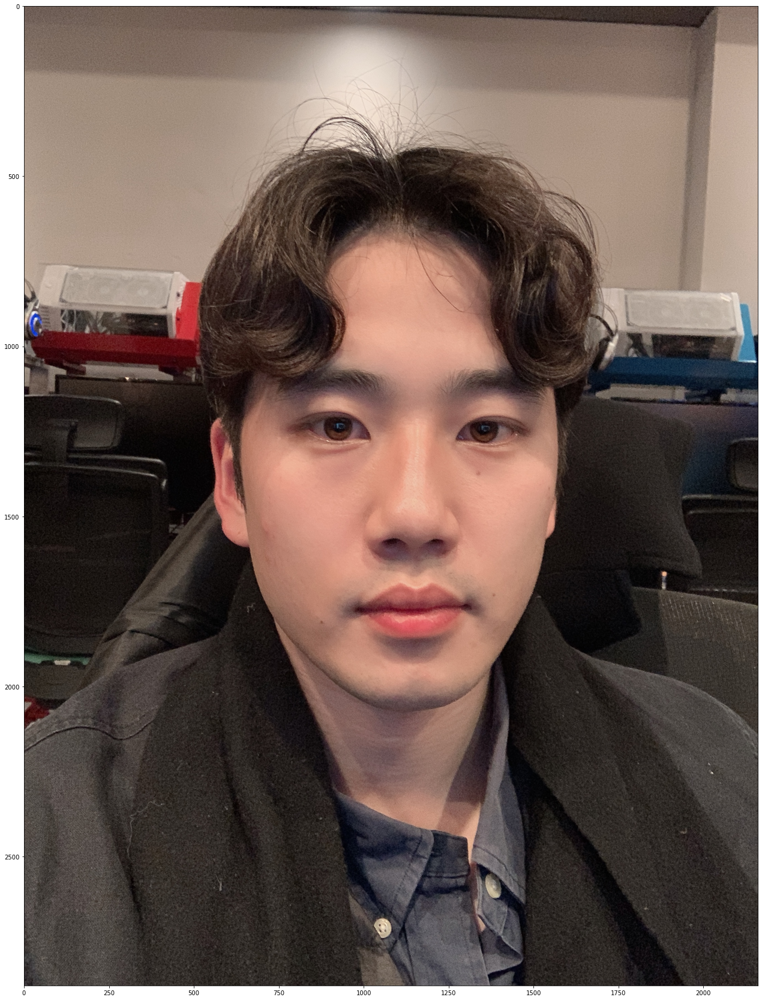

In [29]:
import os
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/photo_0.JPG'
img_bgr = cv2.imread(my_image_path)    #- OpenCV로 이미지를 읽어서
# plt.imshow 이전에 RGB 이미지로 바꾸는 것을 잊지마세요. 
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
#img_bgr = cv2.resize(img_bgr)    # 640x360의 크기로 Resize
img_show = img_bgr.copy()      #- 출력용 이미지 별도 보관
plt.figure(figsize=(40, 30))
plt.imshow(img_rgb)
plt.show()

In [30]:
import dlib
detector_hog = dlib.get_frontal_face_detector()   #- detector 선언
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
dlib_rects = detector_hog(img_rgb, 1)   #- (image, num of img pyramid)

rectangles[[(617, 1043) (1575, 2002)]]


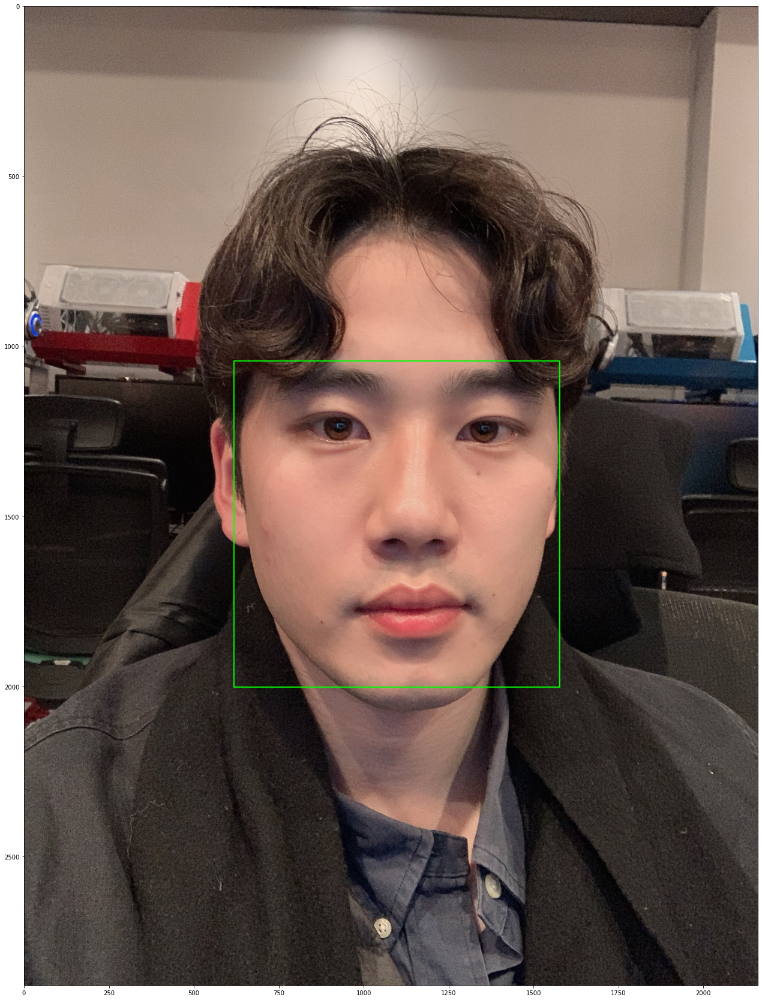

In [31]:
print(dlib_rects)   # 찾은 얼굴영역 좌표

for dlib_rect in dlib_rects:
    l = dlib_rect.left()
    t = dlib_rect.top()
    r = dlib_rect.right()
    b = dlib_rect.bottom()

    cv2.rectangle(img_rgb, (l,t), (r,b), (0,255,0), 2, lineType=cv2.LINE_AA)

#img_show_rgb =  cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(40, 30))
plt.imshow(img_rgb)
plt.show()

```
$ wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
$ mv shape_predictor_68_face_landmarks.dat.bz2 ~/aiffel/camera_sticker/models
$ cd ~/aiffel/camera_sticker && bzip2 -d ./models/shape_predictor_68_face_landmarks.dat.bz2
```

In [32]:
import os
model_path = os.getenv('HOME')+'/aiffel/camera_sticker/models/shape_predictor_68_face_landmarks.dat'
landmark_predictor = dlib.shape_predictor(model_path)

In [33]:
list_landmarks = []
for dlib_rect in dlib_rects:
    points = landmark_predictor(img_rgb, dlib_rect)
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)

print(len(list_landmarks[0]))

68


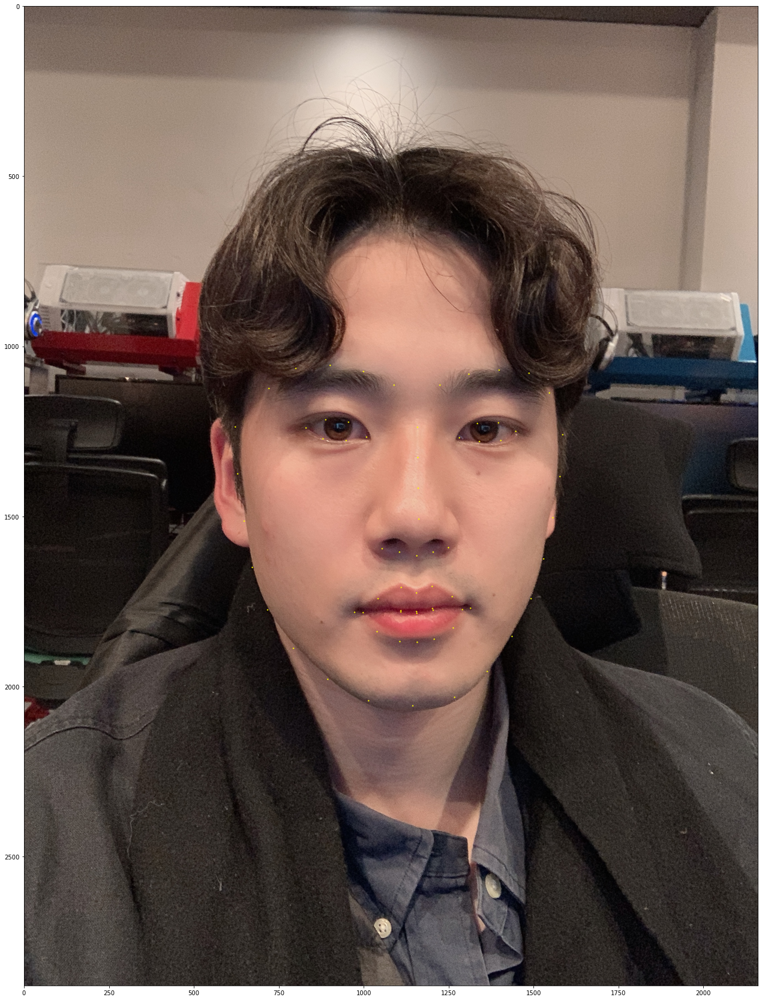

In [34]:
for landmark in list_landmarks:
    for idx, point in enumerate(list_points):
        cv2.circle(img_show, point, 2, (0, 255, 255), -1) # yellow

img_show_rgb = cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(40, 30))
plt.imshow(img_show_rgb)
plt.show()

In [35]:
for dlib_rect, landmark in zip(dlib_rects, list_landmarks):
    print (landmark[30]) # nose center index : 30
    x = landmark[30][0]
    y = landmark[30][1] - dlib_rect.width()//2
    w = dlib_rect.width()
    h = dlib_rect.width()
    print ('(x,y) : (%d,%d)'%(x,y))
    print ('(w,h) : (%d,%d)'%(w,h))

(1161, 1508)
(x,y) : (1161,1029)
(w,h) : (959,959)


(959, 959, 3)


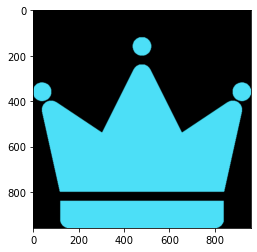

In [36]:
import os
sticker_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/king.png'
img_sticker = cv2.imread(sticker_path)
img_sticker = cv2.resize(img_sticker, (w,h))
print (img_sticker.shape)
plt.imshow(img_sticker)

In [37]:
refined_x = x - w // 2  # left
refined_y = y - h       # top
print ('(x,y) : (%d,%d)'%(refined_x, refined_y))

(x,y) : (682,70)


``` 왕관 이미지가 잘린다면 아래의 코드 실행
img_sticker = img_sticker[-refined_y:]
print (img_sticker.shape)
```

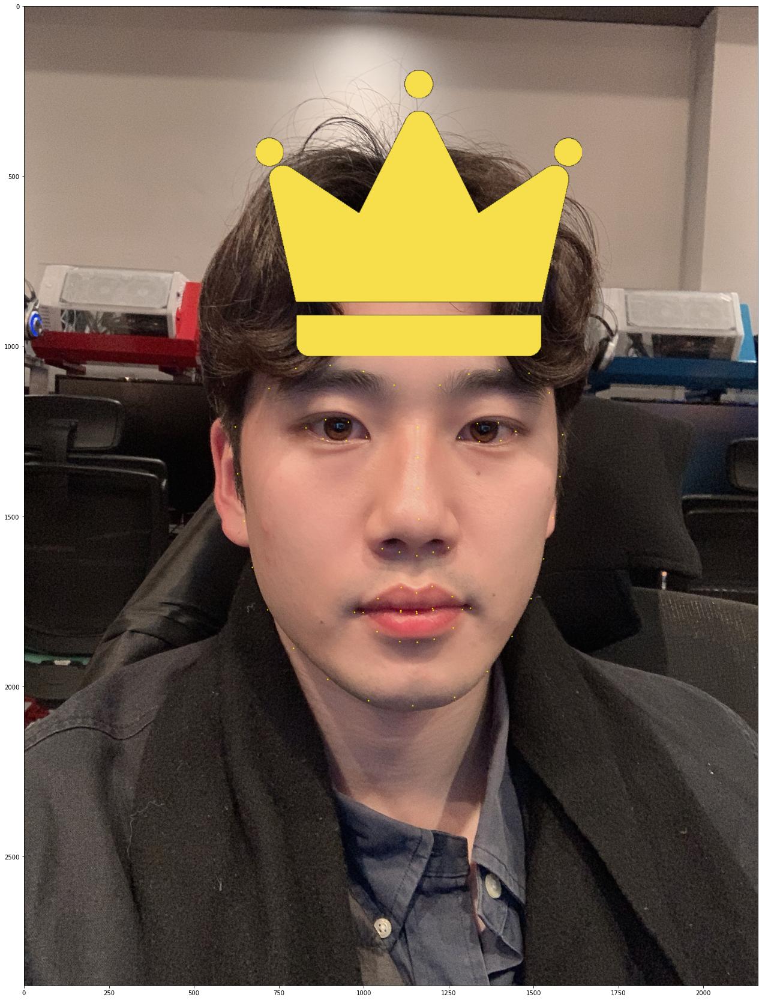

In [38]:
sticker_area = img_show[refined_y:refined_y+img_sticker.shape[0], refined_x:refined_x+img_sticker.shape[1]]
img_show[refined_y:refined_y+img_sticker.shape[0], refined_x:refined_x+img_sticker.shape[1]] = \
    np.where(img_sticker==0,sticker_area,img_sticker).astype(np.uint8)
plt.figure(figsize=(40, 30))
plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
plt.show()

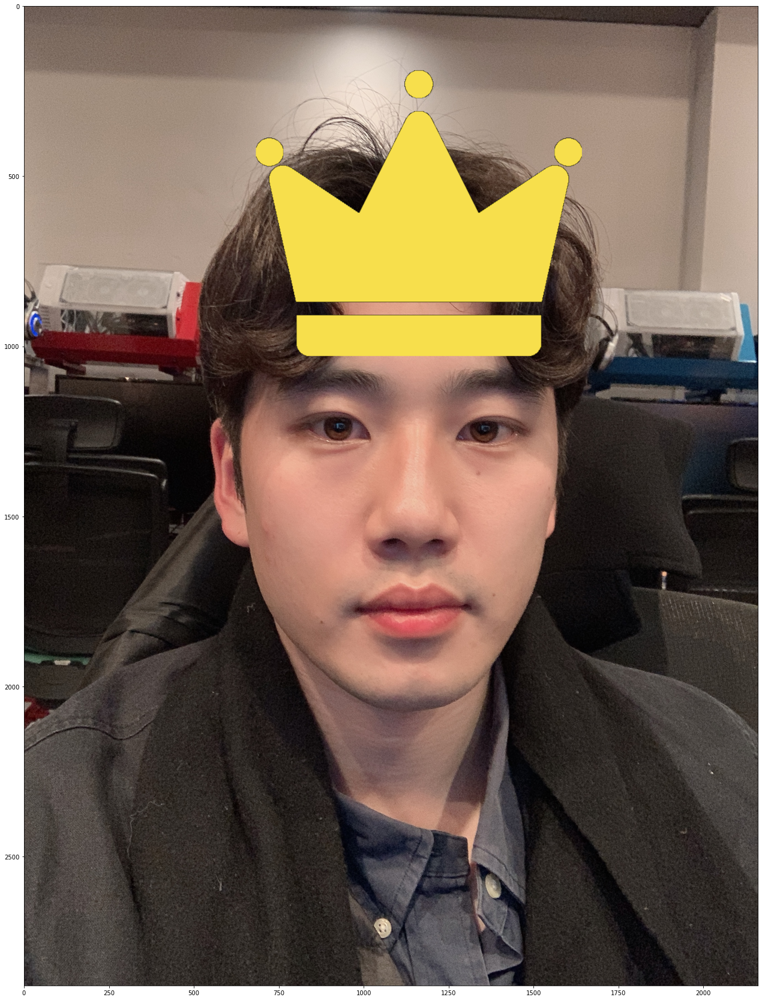

In [39]:
sticker_area = img_bgr[refined_y:refined_y+img_sticker.shape[0], refined_x:refined_x+img_sticker.shape[1]]
img_bgr[refined_y:refined_y+img_sticker.shape[0], refined_x:refined_x+img_sticker.shape[1]] = \
    np.where(img_sticker==0,sticker_area,img_sticker).astype(np.uint8)
plt.figure(figsize=(40, 30))
plt.imshow(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))
plt.show()

In [40]:
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/photo_0.JPG'
img_bgr = cv2.imread(my_image_path)    #- OpenCV로 이미지를 읽어서
# plt.imshow 이전에 RGB 이미지로 바꾸는 것을 잊지마세요. 
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
#img_bgr = cv2.resize(img_bgr)    # 640x360의 크기로 Resize
img_show = img_bgr.copy()  

In [41]:
for dlib_rect, landmark in zip(dlib_rects, list_landmarks):
    print (landmark[66]) # nmouth center index : 66
    x_whiskers = landmark[66][0]
    y_whiskers = landmark[66][1]
    w = dlib_rect.width()
    h = dlib_rect.width()
    print ('(x,y) : (%d,%d)'%(x,y))
    print ('(w,h) : (%d,%d)'%(w,h))

(1155, 1785)
(x,y) : (1161,1029)
(w,h) : (959,959)


(959, 959, 3)
0 [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 24

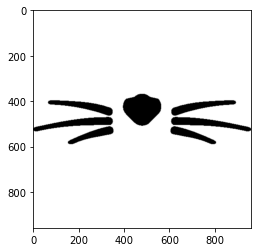

In [42]:
img_whiskers = cv2.imread('cat-whiskers.png')
img_whiskers = cv2.resize(img_whiskers, (w,h))
sticker =img_whiskers

print (sticker.shape)
print(sticker.min(),np.unique(sticker))
#img_whiskers = 255 - img_whiskers
plt.imshow(sticker)

In [43]:
sticker[:,:,2].max()

255

In [44]:
'''
import cairosvg
cairosvg.svg2png(file_obj=open('cat-whiskers.svg','rb'), write_to='whiskers.png')
'''

"\nimport cairosvg\ncairosvg.svg2png(file_obj=open('cat-whiskers.svg','rb'), write_to='whiskers.png')\n"

In [45]:
refined_x = x_whiskers - w // 2  # left
refined_y = y_whiskers - int(h// 1.4) # top
print ('(x,y) : (%d,%d)'%(refined_x, refined_y))

(x,y) : (676,1100)


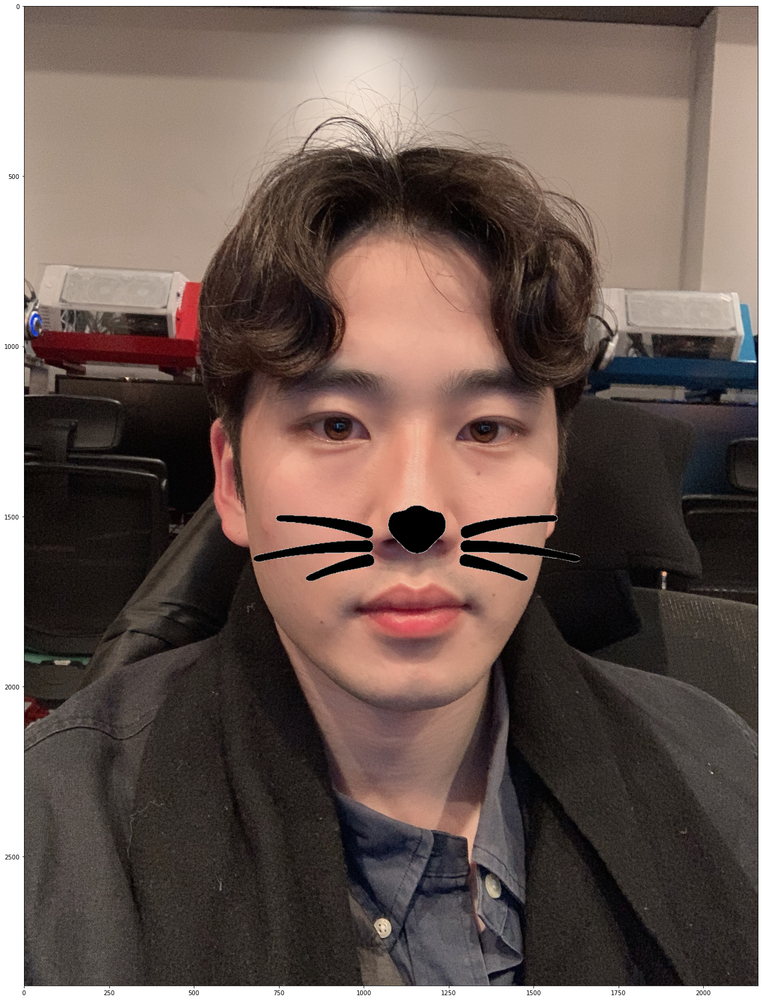

In [46]:
sticker_area = img_bgr[refined_y:refined_y+sticker.shape[0], refined_x:refined_x+sticker.shape[1]]
img_bgr[refined_y:refined_y+sticker.shape[0], refined_x:refined_x+sticker.shape[1]] = \
    np.where(sticker==255,sticker_area,sticker).astype(np.uint8)

plt.figure(figsize=(40, 30))
plt.imshow(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))
plt.show()

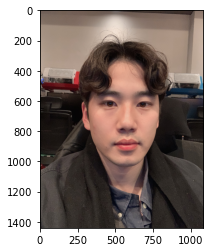

In [53]:
def load_img(img):
    img_bgr = cv2.imread(img)   
    img_bgr = cv2.resize(img_bgr,dsize=(0,0),fx=0.5,fy=0.5) 
    img_show = img_bgr.copy()  
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.show()
    
load_img('photo_0.JPG')

### 얼굴 각도에 따라 스티커가 어떻게 변해야할까요?
 - 얼굴 각도에 따라 스티커도 affine transform을 해주어야 합니다.

### 멀리서 촬영하면 왜 안될까요? 
 - 멀리서 촬영할 경우 HoG의 구조가 너무 작아져 얼굴의 HoG를 찾아내지 못 할 수도 있습니다.
 
### 옆으로 누워서 촬영하면 왜 안될까요?
 - dlib에서 제공하는 landmark를 학습시킬 때, 정면의 얼굴만 학습시킬 경우 누워있는 얼굴은 찾기 힘듭니다. 각도 변화를 고려하지 않고 학습시켰기 때문입니다. 따라서 재학습을 시켜 Rotation Invariance 한 특징을 잡아내야 합니다.
 
### 실행 속도가 중요할까요?
 - 실시간으로 스티커를 붙여서 보여줘야하는 앱의 경우, 실행속도가 real-time을 따라갈 정도로 빨라야 합니다.
 
### 스티커앱을 만들 때 정확도가 얼마나 중요할까요?
 - 사람마다, 얼굴 회전 각도마다, 카메라와 얼굴의 거리, 각도마다 스티커를 Transform시켜줘야 하기 때문에 정확도도 중요합니다.
